# Exploring kernel density estimation
To run this you need following dependencies:
1. pandas
2. seaborn
3. matplotlib
4. sklearn
5. numpy

## Dataset

In [1]:
# import libraries
import pandas as pd 
import seaborn as sns
import matplotlib.pyplot as plt
from urllib import request
# read the data from 'ConfLongDemo_JSI.txt'
colnames = ['Seq_Name', 'Tag_Id', 'Timestamp', 'Date', 'X', 'Y', 'Z', 'Activity']
url = 'https://archive.ics.uci.edu/ml/machine-learning-databases/00196/ConfLongDemo_JSI.txt'
file = request.urlopen(url)
df = pd.read_csv(file)
df.columns = colnames
print(df.head(5))

Seq_Name           Tag_Id           Timestamp                     Date  \
0      A01  020-000-033-111  633790226051820913  27.05.2009 14:03:25:183   
1      A01  020-000-032-221  633790226052091205  27.05.2009 14:03:25:210   
2      A01  010-000-024-033  633790226052361498  27.05.2009 14:03:25:237   
3      A01  010-000-030-096  633790226052631792  27.05.2009 14:03:25:263   
4      A01  020-000-033-111  633790226052902087  27.05.2009 14:03:25:290   

          X         Y         Z Activity  
0  4.291954  1.781140  1.344495  walking  
1  4.359101  1.826456  0.968821  walking  
2  4.087835  1.879999  0.466983  walking  
3  4.324462  2.072460  0.488065  walking  
4  4.364077  1.767691  1.299996  walking  


In [2]:
# filter the data
filtered = df.loc[(df['Activity'] == 'sitting') | 
                  (df['Activity'] == 'walking') | 
                  (df['Activity'] == 'standing up from lying')]
len(filtered)

78314

<Figure size 1080x360 with 0 Axes>

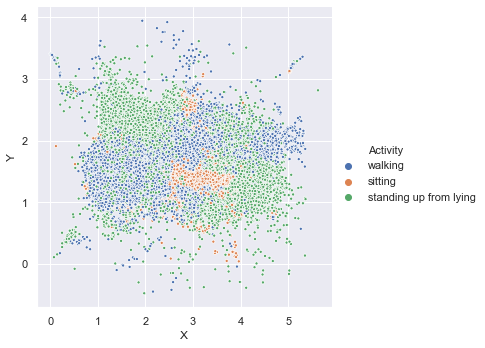

In [6]:
# show filtered data
sns.set()
plt.figure(figsize=(15, 5))
fig = sns.relplot(data=filtered, x='X', y='Y', hue='Activity', s=10)
plt.show(fig)

## Exploring 1D gaussian kernel density estimation
Using only the x of walking data to explore 1D estimation

In [3]:
import numpy as np
# grid for plot
x = filtered.loc[filtered['Activity'] == 'walking']['X']
y = filtered.loc[filtered['Activity'] == 'walking']['Y']
x, y

(0         4.291954
 1         4.359101
 2         4.087835
 3         4.324462
 4         4.364077
             ...   
 164854    3.209474
 164855    3.386878
 164856    3.188895
 164857    3.150169
 164858    3.209994
 Name: X, Length: 32709, dtype: float64, 0         1.781140
 1         1.826456
 2         1.879999
 3         2.072460
 4         1.767691
             ...   
 164854    2.044571
 164855    2.004729
 164856    1.915717
 164857    1.931164
 164858    1.939577
 Name: Y, Length: 32709, dtype: float64)

In [4]:
# Compute the optimal bandwidth(h in the paper) according to Silverman's rule of thumb
# https://en.wikipedia.org/wiki/Kernel_density_estimation
sigma = np.std(x)
q75, q25 = np.percentile(x, [75 ,25])
iqr = q75 - q25
h = (0.9 * min(sigma, iqr/1.34)) / (len(x) ** (1 / 5))
print("optimized bandwidth: {0: .2f}".format(h))

optimized bandwidth:  0.09


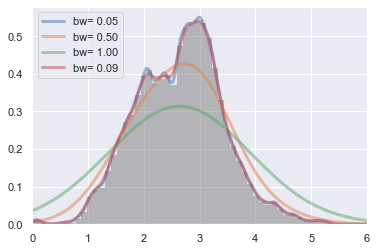

In [7]:
# do estimation and plot
from sklearn.neighbors import KernelDensity

def kde_sklearn(x, x_grid, bandwidth=0.2, **kwargs):
    kde = KernelDensity(bandwidth=bandwidth, **kwargs)
    kde.fit(x[:, np.newaxis])
    # score_samples() returns the log-likelihood of the samples
    log_pdf = kde.score_samples(x_grid[:, np.newaxis])
    return np.exp(log_pdf)

x_grid = np.linspace(0, 6, 1000)
fig, ax = plt.subplots()
for bandwidth in [0.05, 0.5, 1.0, h]:
    ax.plot(x_grid, kde_sklearn(x, x_grid, bandwidth=bandwidth),
            label='bw={0: .2f}'.format(bandwidth), linewidth=3, alpha=0.5)
ax.hist(x, 50, fc='gray', histtype='stepfilled', alpha=0.5, density=True)
ax.set_xlim(0, 6)
ax.legend(loc='upper left')

plt.show(fig)

## Exploring 2D gaussian kernel density estimation
Using only walking data to explore 2D estimation

(2, 32709)
optimized bandwidth: 0.17682979992041684


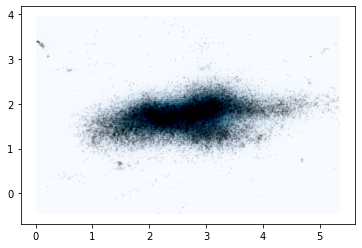

In [5]:
from sklearn.neighbors import KernelDensity

def kde2D(x, y, xbins=100j, ybins=100j, **kwargs): 
    # create grid of sample locations (default: 100x100)
    xx, yy = np.mgrid[x.min():x.max():xbins, 
                      y.min():y.max():ybins]

    xy_sample = np.vstack([xx.ravel(), yy.ravel()])
    xy_train  = np.vstack([x, y])

    d = xy_train.shape[0]
    n = xy_train.shape[1]
    print(xy_train.shape)
    # following code copied from https://gist.github.com/daleroberts/7a13afed55f3e2388865b0ec94cd80d2
    # didn't find silverman's rule of thumb for 2d estimation
    # so assuming this implementation is correct
    # --------------------------------------------------------
    bw = (n * (d + 2) / 4.)**(-1. / (d + 4)) # silverman
    # bw = n**(-1./(d+4)) # scott
    # --------------------------------------------------------
    print('optimized bandwidth: {0}'.format(bw))

    kde_skl = KernelDensity(bandwidth=bw, kernel='gaussian', **kwargs)
    kde_skl.fit(xy_train.T)

    # score_samples() returns the log-likelihood of the samples
    z = np.exp(kde_skl.score_samples(xy_sample.T))
    return xx, yy, np.reshape(z, xx.shape)

xx, yy, zz = kde2D(x, y)

plt.pcolormesh(xx, yy, zz, cmap='Blues')
plt.scatter(x, y, s=1, facecolor='black', alpha=0.05)